✅ Slideshow saved as: slideshow.gif


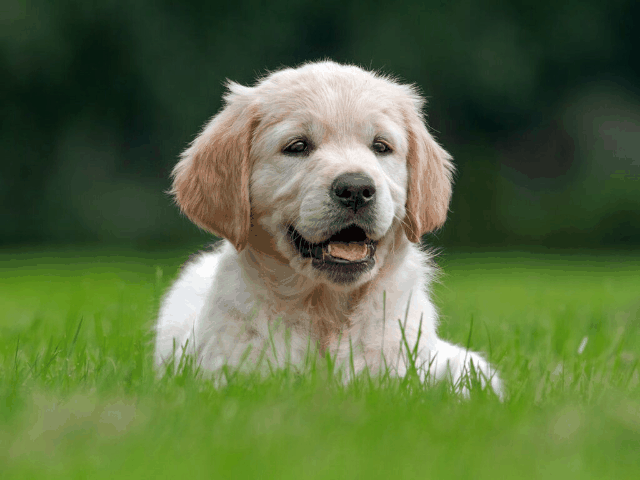

In [ ]:
import cv2
import os
import numpy as np
import matplotlib
matplotlib.use('Agg')  # Use non-GUI backend for headless environments
import imageio.v2 as imageio
from IPython.display import Image, display

# --- Configuration ---
folder = "images"  # Folder containing your images
image_files = ['dog1.jpg', 'parrot.jpg', 'cat.jpeg']  # Filenames inside folder
output_gif = "slideshow.gif"
resize_dim = (640, 480)
transition_steps = 30  # Number of frames in each transition
frame_duration = 0.05  # Seconds per frame in the GIF

# --- Load and resize images ---
images = []
for file in image_files:
    path = os.path.join(folder, file)
    img = cv2.imread(path)
    if img is not None:
        img = cv2.resize(img, resize_dim)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        images.append(img)
    else:
        print(f"[ERROR] Cannot read {file}")

if len(images) < 2:
    raise ValueError("Need at least two images to run slideshow.")

# --- Generate blended transition frames ---
frames = []
for i in range(len(images)):
    current = images[i]
    next_img = images[(i + 1) % len(images)]

    # Hold current image briefly
    for _ in range(5):
        frames.append(current)

    # Transition blend between current and next image
    for j in range(transition_steps + 1):
        alpha = j / transition_steps
        beta = 1.0 - alpha
        blended = cv2.addWeighted(current, beta, next_img, alpha, 0)
        frames.append(blended)

# --- Save as animated GIF ---
imageio.mimsave(output_gif, frames, duration=frame_duration)
print(f"✅ Slideshow saved as: {output_gif}")

# --- Display inside notebook ---
display(Image(filename=output_gif))